In [1]:
from datetime import datetime
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
import metpy.calc as mpcalc
from metpy.units import units
import numpy as np
from scipy.ndimage import gaussian_filter
import xarray as xr
from matplotlib.ticker import ScalarFormatter
from cmcrameri import cm


In [4]:
times = ['2020-06-30T06', '2020-06-30T18', '2020-07-01T06', '2020-07-01T18']
letters = ['a)', 'b)', 'c)', 'd)']

#open surface_ERA.nc
era_surf = xr.open_dataset('surface_ERA.nc')
#get only the data for the last 2 days of jun 2020
era_surf = era_surf.sel(time=slice('2020-06-30', '2020-07-02'))
#era_surf in the range of -80 to -20 in longitude and -70 to 10 in latitude
era_surf = era_surf.sel(longitude=slice(-80, -30), latitude=slice(10,-60))

#open era5
era_l = xr.open_dataset('ERA5_pressure.nc')
#get only the data for the last 2 days of jun 2020
era_l = era_l.sel(time=slice('2020-06-28', '2020-07-02'))
#era in the range of -80 to -20 in longitude and -70 to 10 in latitude
era_l = era_l.sel(longitude=slice(-80, -30), latitude=slice(10,-60))

era_temp = xr.open_dataset('era_temp.nc')
era_temp = era_temp.sel(time=slice('2020-06-28', '2020-07-02'))
era_temp = era_temp.sel(longitude=slice(-80, -30), latitude=slice(10,-60))
#from Geopotential, calculate the Geopotential height
g = 9.80665
era_l['z'] = (era_l.z / g).astype('float32')
#calculate thickness between 1000 and 500 hPa
era_l['thickness'] = era_l.z.sel(level=500)-era_l.z.sel(level=1000) 


In [3]:
# Set up the projection that will be used for plotting
mapcrs = ccrs.PlateCarree()
# Set up the projection of the data; if lat/lon then PlateCarree is what you want
datacrs = ccrs.PlateCarree()
clevs_500_hght = np.arange(0, 8000, 50)
clevs_250_sped = np.arange(30, 180, 30)


# pressure

In [4]:

from scipy.ndimage.filters import maximum_filter, minimum_filter

def plot_maxmin_points(ax,lon, lat, data, extrema, nsize, symbol, color='k',
                       plotValue=True, transform=None, pad=50):
    """
    This function will find and plot relative maximum and minimum for a 2D grid. The function
    can be used to plot an H for maximum values (e.g., High pressure) and an L for minimum
    values (e.g., low pressue). It is best to used filetered data to obtain  a synoptic scale
    max/min value. The symbol text can be set to a string value and optionally the color of the
    symbol and any plotted value can be set with the parameter color
    lon = plotting longitude values (2D)
    lat = plotting latitude values (2D)
    data = 2D data that you wish to plot the max/min symbol placement
    extrema = Either a value of max for Maximum Values or min for Minimum Values
    nsize = Size of the grid box to filter the max and min values to plot a reasonable number
    symbol = String to be placed at location of max/min value
    color = String matplotlib colorname to plot the symbol (and numerica value, if plotted)
    plot_value = Boolean (True/False) of whether to plot the numeric value of max/min point
    The max/min symbol will be plotted on the current axes within the bounding frame
    (e.g., clip_on=True)
    """

    if (extrema == 'max'):
        data_ext = maximum_filter(data, nsize, mode='nearest')
    elif (extrema == 'min'):
        data_ext = minimum_filter(data, nsize, mode='nearest')
    else:
        raise ValueError('Value for hilo must be either max or min')

    mxy, mxx = np.where(data_ext == np.array(data))

    for i in range(len(mxy)):
        #only plot if its not pad pixels from the edge of the grid
        if mxx[i] > pad and mxx[i] < data.shape[1] - pad and mxy[i] > pad and mxy[i] < data.shape[0] - pad:

            ax.text(lon[mxx[i]], lat[mxy[i]], symbol, color=color, size=24,
                clip_on=True, horizontalalignment='center', verticalalignment='center',
                transform=transform)
        #ax.text(lon[mxx[i]], lat[mxx[i]],
        #        '\n' + str(np.int(data[mxy[i], mxx[i]])),
        #        color=color, size=12, clip_on=True, fontweight='bold',
        #        horizontalalignment='center', verticalalignment='top', transform=transform)


# Plot thickness with multiple colors
clevs = (np.arange(0, 5400, 60),
         np.array([5400]),
         np.arange(5460, 7000, 60))
colors = ('tab:blue', 'b', 'tab:red')
kw_clabels = {'fontsize': 11, 'inline': True, 'inline_spacing': 5, 'fmt': '%i',
              'rightside_up': True, 'use_clabeltext': True}
    

C:\Users\luisg\AppData\Local\Temp\ipykernel_24336\4138408096.py:1: DeprecationWarning: Please use `maximum_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import maximum_filter, minimum_filter
C:\Users\luisg\AppData\Local\Temp\ipykernel_24336\4138408096.py:1: DeprecationWarning: Please use `minimum_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import maximum_filter, minimum_filter


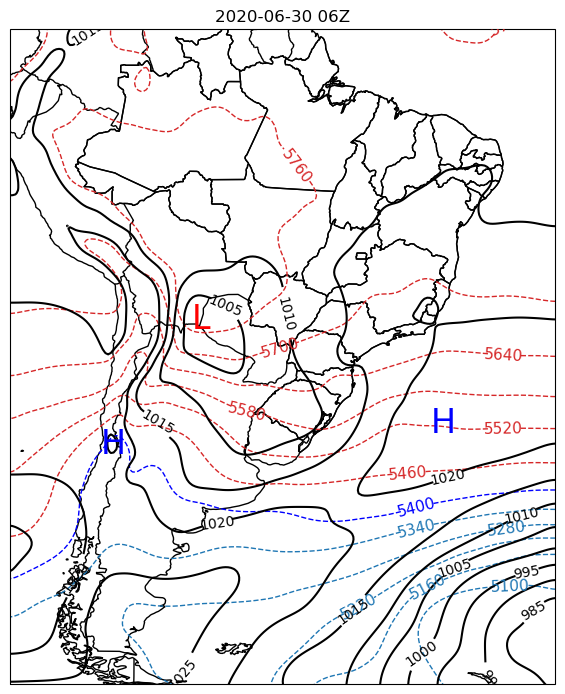

In [5]:
tt = times[0]
ds = era_surf.sel(time=tt)
lats = ds.latitude.data
lons = ds.longitude.data
# Select and grab data
mslp = ds['msl'].data
# Apply gaussian filter to the MSLP
mslp_surf = gaussian_filter(mslp.data, sigma=3.0) 
mslp_hpa = mslp_surf / 100
ds['msl'] = ds['msl'] / 100
strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')



fig, ax = plt.subplots(1, 1, figsize=(11, 8.5), subplot_kw=dict(projection=datacrs))
thickness = gaussian_filter(era_l['thickness'].sel(time=tt).data, sigma=3.0) 
for clevthick, color in zip(clevs, colors):
    cs = ax.contour(lons, lats, thickness, levels=clevthick, colors=color,
                    linewidths=1.0, linestyles='dashed', transform=datacrs)
    plt.clabel(cs, **kw_clabels)


# Plot MSLP Contour
MSLP_range = np.arange(980, 1030, 5)
prs = ax.contour(lons, lats, mslp_hpa, MSLP_range, colors='k',
                 transform=datacrs)
ax.clabel(prs, fmt='%d')

# Add geopolitical boundaries for map reference
ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
ax.add_feature(cfeature.STATES.with_scale('50m'))
ax.add_feature(cfeature.BORDERS.with_scale('50m'))
#CS = ds['msl'].plot.contour(ax=ax,levels=20,  cmap='grey', vcenter=1010)
#ax.clabel(CS)

plot_maxmin_points(ax, lons, lats, mslp_hpa, 'max', 90, symbol='H', color='b', transform=datacrs, pad=20)
plot_maxmin_points(ax, lons, lats, mslp_hpa, 'min', 90, symbol='L', color='r', transform=datacrs, pad=20)

ax.set_extent([-80, -30, -55, 5], crs=datacrs)

ax.title.set_text(strtime)

In [6]:
MSLP_range = np.arange(980, 1030, 5)


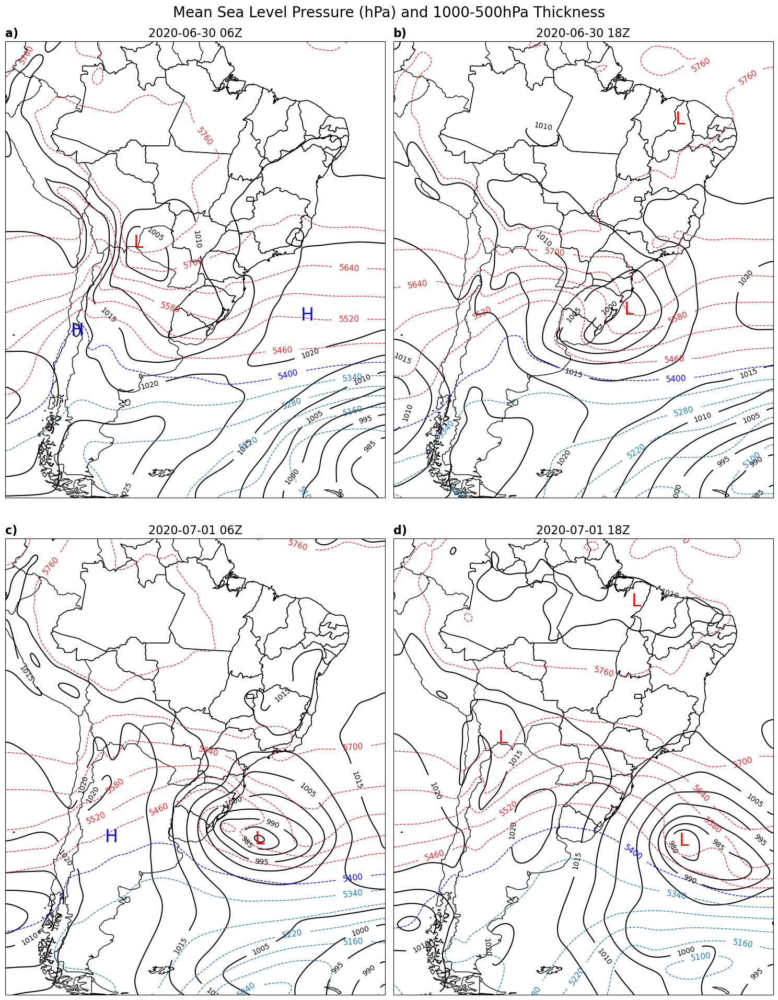

In [7]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()
for i, tt in enumerate(times):
    ds = era_surf.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data

    # Select and grab data
    mslp = ds['msl'].data

    # Apply gaussian filter to the MSLP
    mslp_surf = gaussian_filter(mslp, sigma=3.0)
    mslp_hpa = mslp_surf / 100
    ds['msl'] = ds['msl'] / 100
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')

      # Calculate the row and column for the current subplot
    ax = axes[i]  # Get the current axis

    # Plot MSLP Contour
    prs = ax.contour(lons, lats, mslp_hpa, MSLP_range, colors='k', transform=datacrs)
    ax.clabel(prs, fmt='%d')

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))

    plot_maxmin_points(ax, lons, lats, mslp_hpa, 'max', 90, symbol='H', color='b', transform=datacrs, pad=20)
    plot_maxmin_points(ax, lons, lats, mslp_hpa, 'min', 90, symbol='L', color='r', transform=datacrs, pad=20)

    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16)
    thickness = gaussian_filter(era_l['thickness'].sel(time=tt).data, sigma=3.0) 
    for clevthick, color in zip(clevs, colors):
        cs = ax.contour(lons, lats, thickness, levels=clevthick, colors=color,
                        linewidths=1.0, linestyles='dashed', transform=datacrs)
        ax.clabel(cs, **kw_clabels)



fig.suptitle('Mean Sea Level Pressure (hPa) and 1000-500hPa Thickness', fontsize=20)

plt.tight_layout()
plt.show()

# jet 

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\220106908.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


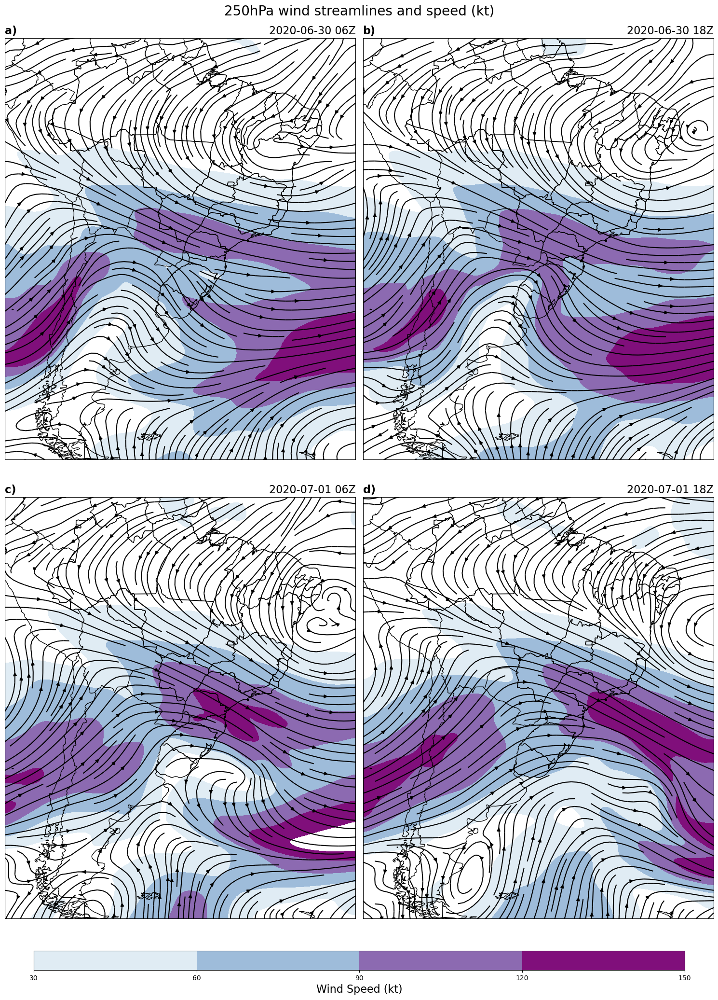

In [128]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    uwnd = ds['u']
    vwnd = ds['v']

    # Use MetPy to calculate the wind speed for colorfill plot, change units to knots from m/s
    uwnd_250 = gaussian_filter(uwnd.sel(level=250).data, sigma=3.0) * units('m/s')
    vwnd_250 = gaussian_filter(vwnd.sel(level=250).data, sigma=3.0) * units('m/s')
    sped_250 = mpcalc.wind_speed(uwnd_250, vwnd_250).to('kt')
    ax = axes[i]
    # Plot 500-hPa Colorfill Wind Speeds in knots
    cf = ax.contourf(lons, lats, sped_250, clevs_250_sped, cmap=plt.cm.BuPu,
                     transform=datacrs)
    

    # Plot 500-hPa Geopotential Heights in meters
    #cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black',
    #               transform=datacrs)
    #ax.clabel(cs, fmt='%d')
    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    uwnd_250 = uwnd.sel(level=250).data * units('m/s')
    vwnd_250 = vwnd.sel(level=250).data * units('m/s')
    ax.streamplot(lons, lats, uwnd_250.to('kt').m, vwnd_250.to('kt').m, transform=datacrs, density=2, color='k')
# Start the figure and create plot axes with proper projection


    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')

cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(cf, cax=cax, orientation='horizontal')
cb.set_label('Wind Speed (kt)', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('250hPa wind streamlines and speed (kt)', fontsize=20)

plt.tight_layout()
plt.show()

# diver

c:\Users\luisg\anaconda3\envs\geo_env\lib\site-packages\cartopy\mpl\geoaxes.py:1614: UserWarning: The following kwargs were not used by contour: 'legend'
  result = super().contour(*args, **kwargs)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\1333830452.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


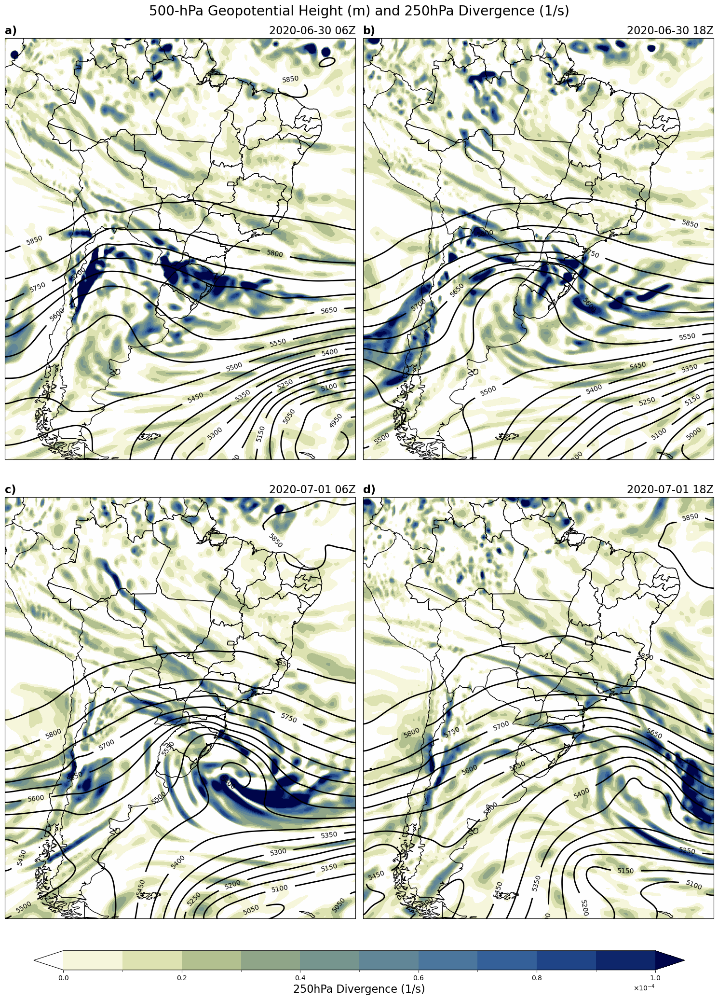

In [130]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = ds['d'].sel(level=250).plot.contourf(ax=ax, levels=11, cmap=cm.davos_r, add_colorbar=False, vmin=0, vmax=0.0001)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('250hPa Divergence (1/s)', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('500-hPa Geopotential Height (m) and 250hPa Divergence (1/s)', fontsize=20)
cb.formatter = ScalarFormatter(useMathText=True)
cb.formatter.set_powerlimits((-2, 2))
cb.update_ticks()
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

# wind 850


C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3497129850.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


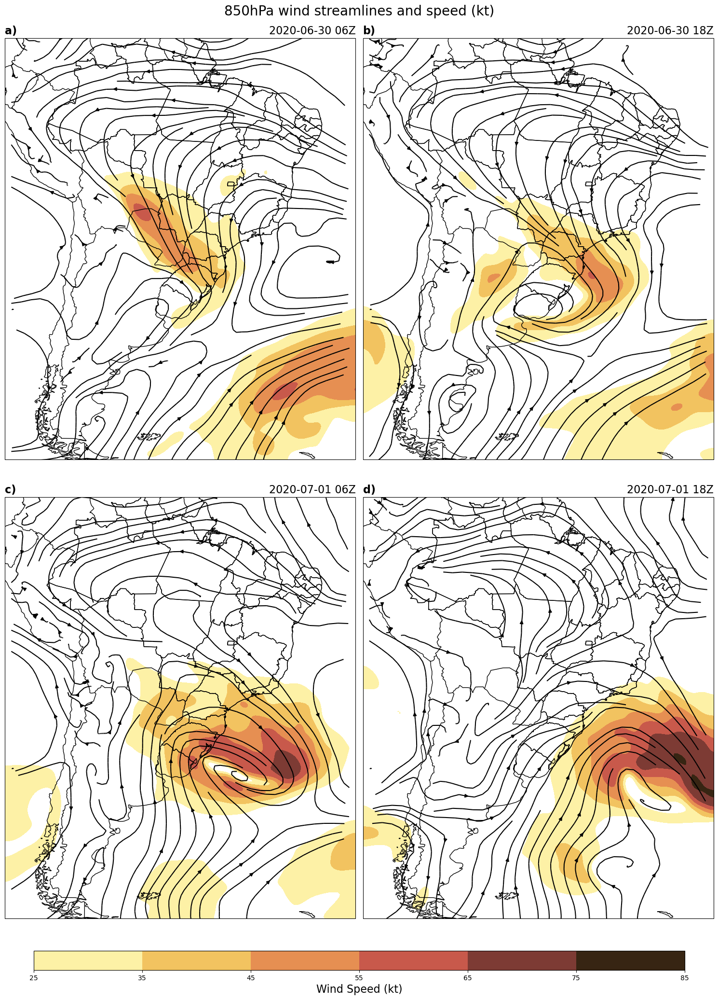

In [131]:
clevs_850_sped = np.arange(25, 86, 10)

fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()
for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
    uwnd = ds['u']
    vwnd = ds['v']

    ax = axes[i]

    uwnd_850 = uwnd.sel(level=850).data * units('m/s')
    vwnd_850 = vwnd.sel(level=850).data * units('m/s')
    ax.streamplot(lons, lats, uwnd_850.to('kt').m, vwnd_850.to('kt').m, transform=datacrs, density=8, color='k')

    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')

    # Use MetPy to calculate the wind speed for colorfill plot, change units to knots from m/s
    uwnd_850 = gaussian_filter(uwnd.sel(level=850).data, sigma=3.0) * units('m/s')
    vwnd_850 = gaussian_filter(vwnd.sel(level=850).data, sigma=3.0) * units('m/s')
    sped_850 = mpcalc.wind_speed(uwnd_850, vwnd_850).to('kt')
    ax = axes[i]
    # Plot 500-hPa Colorfill Wind Speeds in knots
    cf = ax.contourf(lons, lats, sped_850, clevs_850_sped, cmap=cm.lajolla,
                     transform=datacrs)
    
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('850hPa wind streamlines and speed (kt)', fontsize=20)

cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(cf, cax=cax, orientation='horizontal')
cb.set_label('Wind Speed (kt)', size=16)

plt.tight_layout()
plt.show()

# squall line

In [8]:
era_cape = xr.open_dataset('era_tp_cape.nc')
era_l['u_shear'] = era_l['u'].sel(level=500) - era_l['u'].sel(level=850)
era_l['v_shear'] = era_l['v'].sel(level=500) - era_l['v'].sel(level=850)


C:\Users\luisg\AppData\Local\Temp\ipykernel_24336\3889136544.py:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


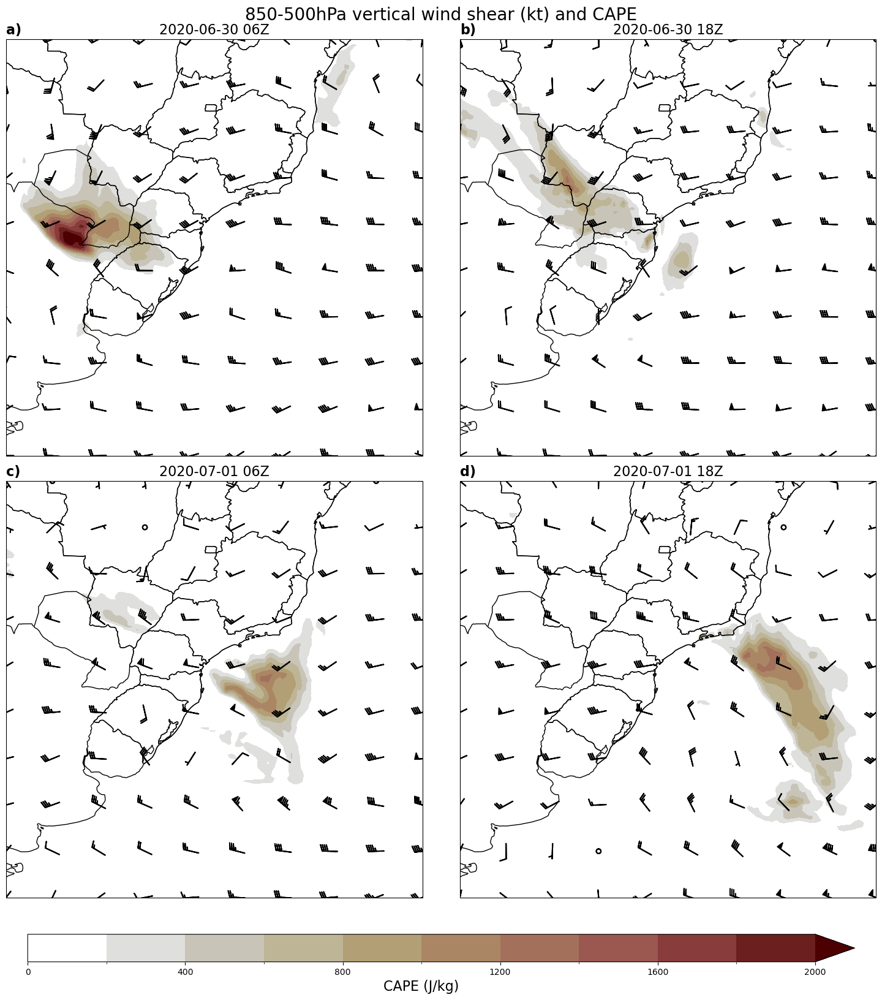

In [13]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()
for i, tt in enumerate(times):
    ds = era_cape.sel(time=tt)
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    ax = axes[i]


    cf = ds.cape.plot.contourf(ax=ax, levels=11, cmap=cm.bilbao, add_colorbar=False, vmin=0, vmax=2000)
    ax.set_title('', fontsize=16)
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-65, -30, -45, -10], crs=datacrs)
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16)

    #calculate the wind shear between 850 and 500 hPa
    ds_shear = era_l.sel(time=tt)
    u_shear = gaussian_filter(ds_shear['u_shear'].data, sigma=3.0) * units('m/s')
    v_shear = gaussian_filter(ds_shear['v_shear'].data, sigma=3.0) * units('m/s')
    shear = mpcalc.wind_speed(u_shear, v_shear).to('kt')
 
    lons = ds_shear.longitude.data
    lats = ds_shear.latitude.data
    #plot the shear
    cs = ax.barbs(lons, lats,  u_shear.to('kt').m,v_shear.to('kt').m,transform=datacrs, length=6, regrid_shape=10, pivot='middle', linewidth=1.5)

    #plot countours of shear
    #cs = ax.contour(lons, lats, shear, levels=[20, 30, 40], colors='k', linewidths=2.0, transform=datacrs)
    #ax.clabel(cs, fmt='%d')

    
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('850-500hPa vertical wind shear (kt) and CAPE', fontsize=20)

cax = fig.add_axes([0.05, -0.06, 0.9, 0.03])
cb = fig.colorbar(cf, cax=cax, orientation='horizontal')
cb.set_label('CAPE (J/kg)', size=16)

plt.tight_layout()
plt.show()

# precipitation

C:\Users\luisg\AppData\Local\Temp\ipykernel_9372\2360132389.py:35: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


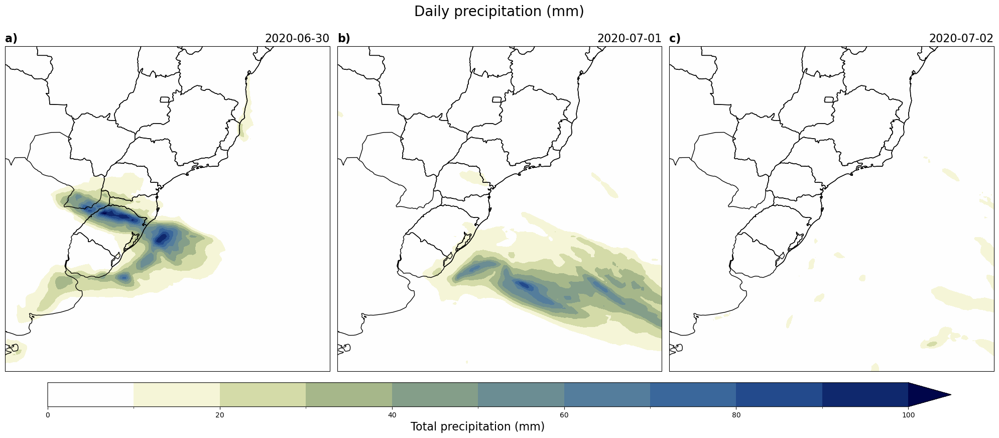

In [7]:
era_tp = xr.open_dataset('era_tp_cape.nc')
#from hourly to daily
era_tp = era_tp.resample(time='1D').sum()
# from unit meters to mm
era_tp = era_tp * 1000
#select only in the region

dayss = ['2020-06-30', '2020-07-01', '2020-07-02']

fig, axes = plt.subplots(1, 3, figsize=(20,8), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()
for i, tt in enumerate(dayss):
    ds = era_tp.sel(time=tt)
    # Select and grab data
    ax = axes[i]

    
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-65, -30, -45, -10], crs=datacrs)
    #plot a), b), c), d) in the right upper corner
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(tt, fontsize=16, loc='right')
    im = ds['tp'].plot.contourf(ax=ax, levels=11, cmap=cm.davos_r, add_colorbar=False, vmin=0, vmax=100)
    ax.set_title('', fontsize=16)
    
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('Daily precipitation (mm)', fontsize=20)

cax = fig.add_axes([0.05, -0.02, 0.9, 0.06])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('Total precipitation (mm)', size=16)

plt.tight_layout()
plt.show()

# tests

## umidade

c:\Users\luisg\anaconda3\envs\geo_env\lib\site-packages\cartopy\mpl\geoaxes.py:1614: UserWarning: The following kwargs were not used by contour: 'legend'
  result = super().contour(*args, **kwargs)
C:\Users\luisg\AppData\Local\Temp\ipykernel_9372\2661723959.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


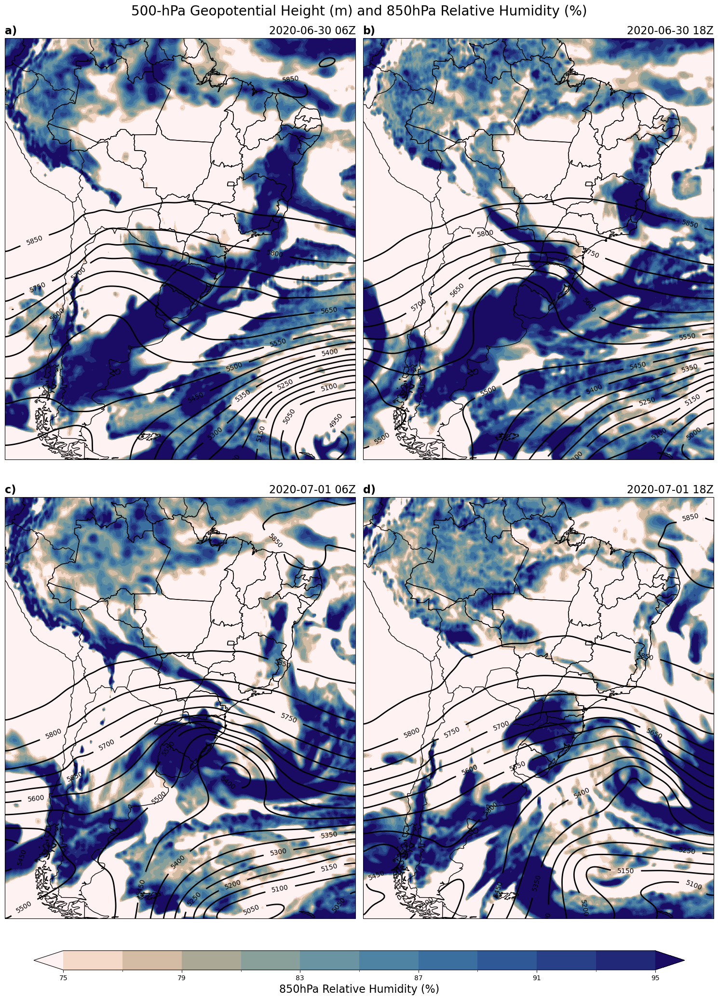

In [9]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = ds['r'].sel(level=850).plot.contourf(ax=ax, levels=11, cmap=cm.lapaz_r, add_colorbar=False, vmin=75, vmax=95)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('850hPa Relative Humidity (%)', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('500-hPa Geopotential Height (m) and 850hPa Relative Humidity (%)', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\1029551341.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


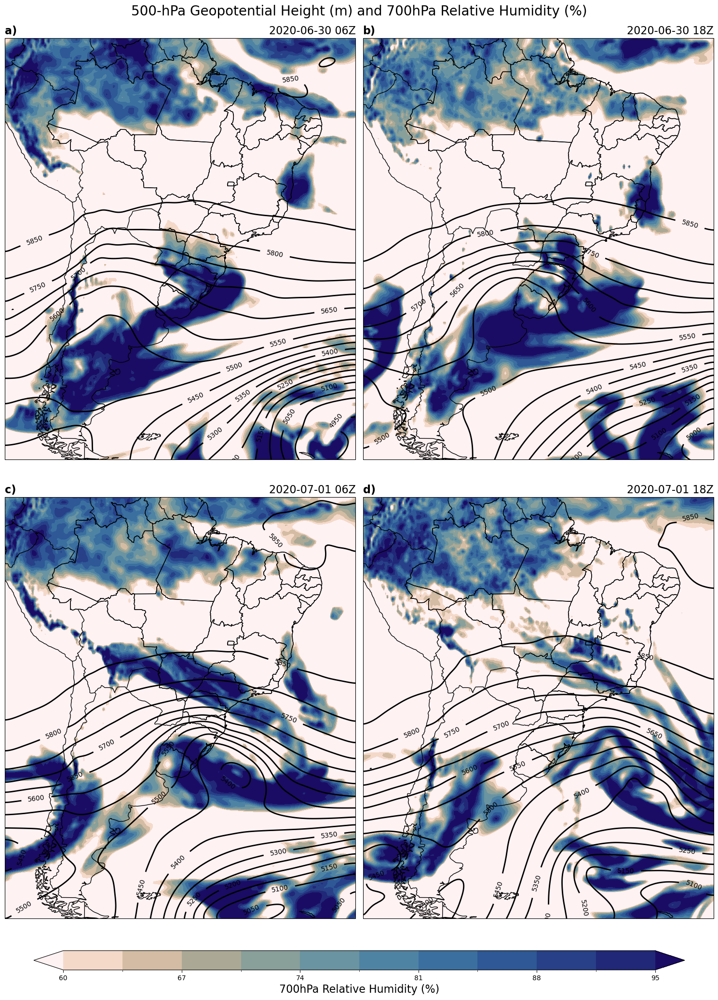

In [269]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_temp.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = era_l.sel(time=tt)['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = ds['r'].sel(level=700).plot.contourf(ax=ax, levels=11, cmap=cm.lapaz_r, add_colorbar=False, vmin=60, vmax=95)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('700hPa Relative Humidity (%)', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('500-hPa Geopotential Height (m) and 700hPa Relative Humidity (%)', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3487859796.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


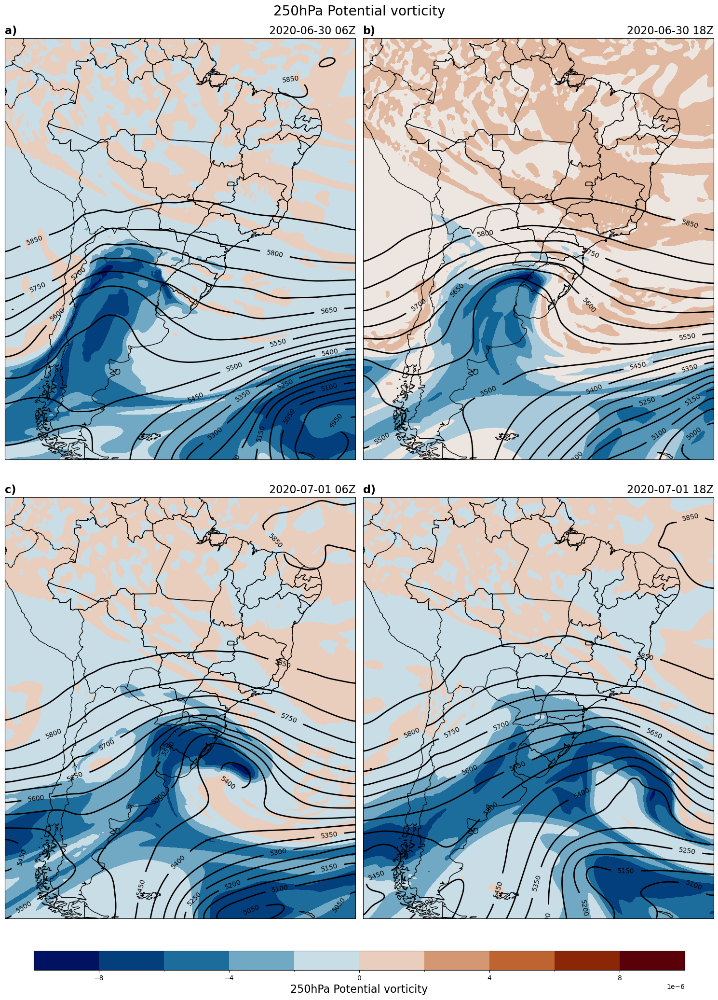

In [156]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = ds['pv'].sel(level=250).plot.contourf(ax=ax, levels=11, cmap=cm.vik, add_colorbar=False, vmin=-0.00001, vmax=0.00001)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('250hPa Potential vorticity', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('250hPa Potential vorticity', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

In [ ]:
tt = times[0]
ds = era_surf.sel(time=tt)
lats = ds.latitude.data
lons = ds.longitude.data
# Select and grab data
mslp = ds['msl'].data
# Apply gaussian filter to the MSLP
mslp_surf = gaussian_filter(mslp.data, sigma=3.0) 
mslp_hpa = mslp_surf / 100
ds['msl'] = ds['msl'] / 100
strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')



fig, ax = plt.subplots(1, 1, figsize=(11, 8.5), subplot_kw=dict(projection=datacrs))
thickness = gaussian_filter(era_l['thickness'].sel(time=tt).data, sigma=3.0) 
for clevthick, color in zip(clevs, colors):
    cs = ax.contour(lons, lats, thickness, levels=clevthick, colors=color,
                    linewidths=1.0, linestyles='dashed', transform=datacrs)
    plt.clabel(cs, **kw_clabels)


# Plot MSLP Contour
MSLP_range = np.arange(980, 1030, 5)
prs = ax.contour(lons, lats, mslp_hpa, MSLP_range, colors='k',
                 transform=datacrs)
ax.clabel(prs, fmt='%d')

# Add geopolitical boundaries for map reference
ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
ax.add_feature(cfeature.STATES.with_scale('50m'))
ax.add_feature(cfeature.BORDERS.with_scale('50m'))
#CS = ds['msl'].plot.contour(ax=ax,levels=20,  cmap='grey', vcenter=1010)
#ax.clabel(CS)

plot_maxmin_points(ax, lons, lats, mslp_hpa, 'max', 90, symbol='H', color='b', transform=datacrs, pad=20)
plot_maxmin_points(ax, lons, lats, mslp_hpa, 'min', 90, symbol='L', color='r', transform=datacrs, pad=20)

ax.set_extent([-80, -30, -55, 5], crs=datacrs)

ax.title.set_text(strtime)

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3831092127.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


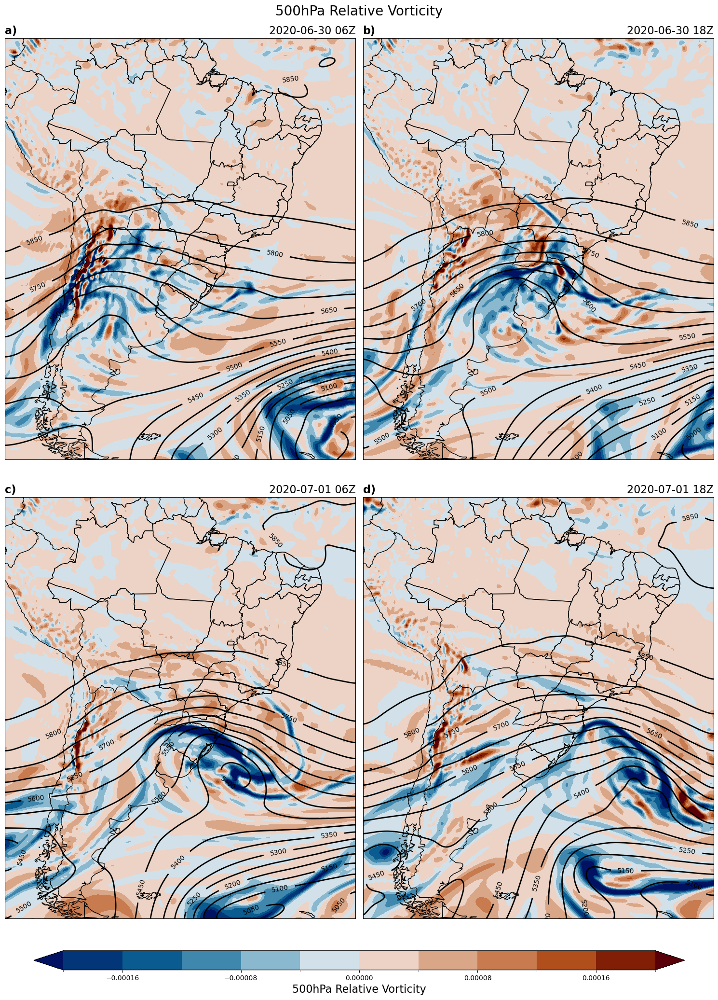

In [161]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = ds['vo'].sel(level=500).plot.contourf(ax=ax, levels=11, cmap=cm.vik, add_colorbar=False, vmin=-0.0002, vmax=0.0002)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('500hPa Relative Vorticity', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('500hPa Relative Vorticity', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

## vorticity

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3022806750.py:50: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


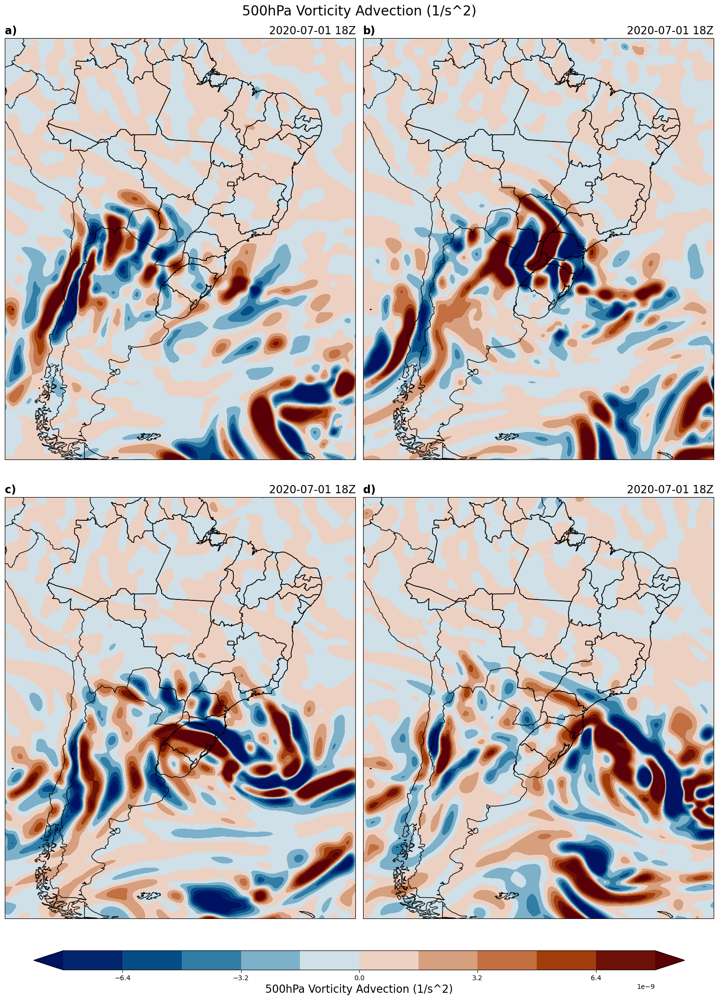

In [256]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    ax = axes[i]
    hght_500 = gaussian_filter(ds['z'].sel(level=500).data, sigma=3.0)
    
    uwnd_500 = ds['u'].sel(level=500).data * units('m/s')
    vwnd_500 = ds['v'].sel(level=500).data * units('m/s')
    
    dx, dy = mpcalc.lat_lon_grid_deltas(lons, lats)
    
    f = mpcalc.coriolis_parameter(np.deg2rad(lats)).to(units('1/sec'))
    #transform to f to shape of uwnd_500, repeating the values
    f = np.tile(f, (uwnd_500.shape[1], 1)).T
    
    avor = mpcalc.vorticity(u=uwnd_500, v=vwnd_500, dx=dx, dy = dy) + f
    
    avor = gaussian_filter(avor, sigma=3, order=0) * units('1/s')
    vort_adv = mpcalc.advection(avor, u=uwnd_500, v=vwnd_500, dx=dx, dy=dy)

    #cs2 = ax.contour(lons, lats, avor*10**5, clevvort500, colors='grey',
    #                 linewidths=1.25, linestyles='dashed', transform=ccrs.PlateCarree())
    #ax.clabel(cs2, fontsize=10, inline=1, inline_spacing=10, fmt='%i',
    #       rightside_up=True, use_clabeltext=True)

    clev_avoradv = np.linspace(-0.000000008, 0.000000008, 11)
    cf = ax.contourf(lons, lats, vort_adv.m, clev_avoradv, extend='both',
                 cmap=cm.vik, transform=ccrs.PlateCarree())
    
    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')

cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(cf, cax=cax, orientation='horizontal')
cb.set_label('500hPa Vorticity Advection (1/s^2)', size=16)
fig.suptitle('500hPa Vorticity Advection (1/s^2)', fontsize=20)



plt.tight_layout()
plt.show()
    

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3612465181.py:11: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  tadv = mpcalc.advection(ds.vo, ds.u, ds.v)


C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3612465181.py:11: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  tadv = mpcalc.advection(ds.vo, ds.u, ds.v)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3612465181.py:11: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  tadv = mpcalc.advection(ds.vo, ds.u, ds.v)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3612465181.py:11: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  tadv = mpcalc.advection(ds.vo, ds.u, ds.v)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3612465181.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


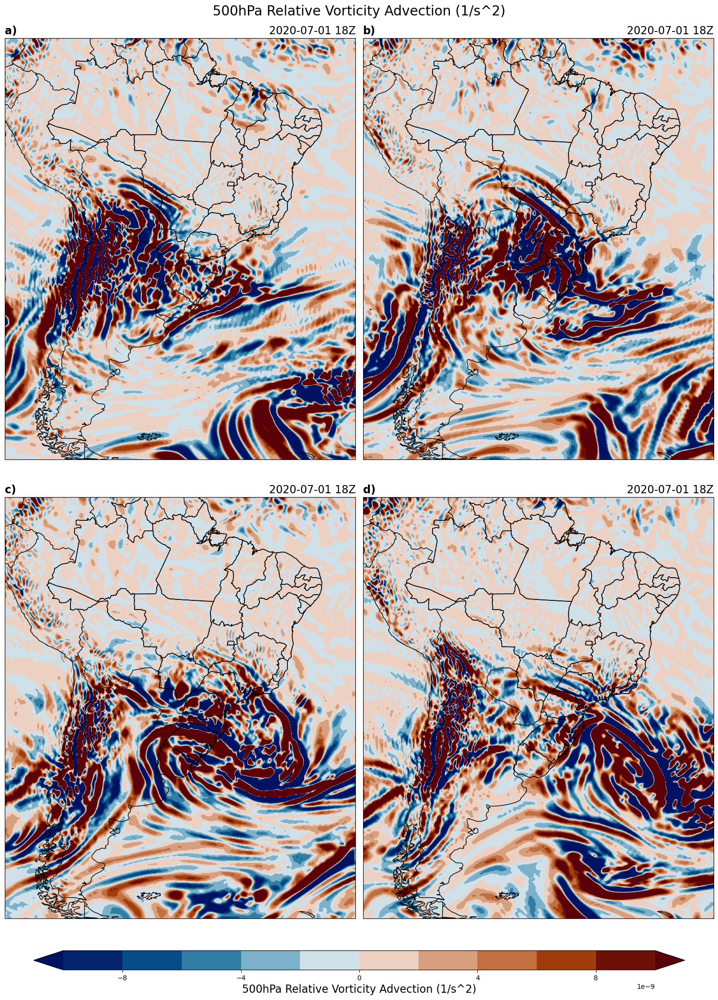

In [257]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    ax = axes[i]
    ds = era_l.sel(time=tt, level=500)
    
    tadv = mpcalc.advection(ds.vo, ds.u, ds.v)

    #cs2 = ax.contour(lons, lats, avor*10**5, clevvort500, colors='grey',
    #                 linewidths=1.25, linestyles='dashed', transform=ccrs.PlateCarree())
    #ax.clabel(cs2, fontsize=10, inline=1, inline_spacing=10, fmt='%i',
    #       rightside_up=True, use_clabeltext=True)

    clev_avoradv = np.linspace(-0.00000001, 0.00000001, 11)
 
    cf = ax.contourf(ds.longitude, ds.latitude, tadv, clev_avoradv,
                 extend='both',
                 cmap=cm.vik, transform=ccrs.PlateCarree())
    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')

cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(cf, cax=cax, orientation='horizontal')
cb.set_label('500hPa Relative Vorticity Advection (1/s^2)', size=16)
fig.suptitle('500hPa Relative Vorticity Advection (1/s^2)', fontsize=20)


plt.tight_layout()
plt.show()

## temp

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\1460616993.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


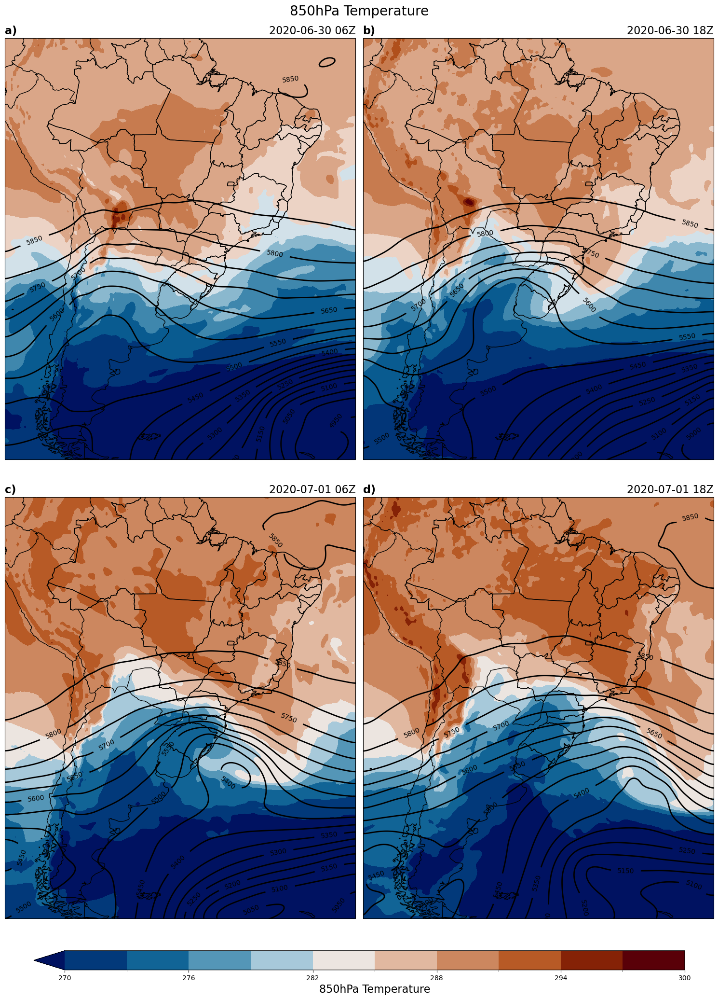

In [286]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = era_temp['t'].sel(time=tt).sel(level=850).plot.contourf(ax=ax, levels=11, cmap=cm.vik, add_colorbar=False, vmin=270, vmax=300)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('850hPa Temperature', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('850hPa Temperature', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\914870717.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


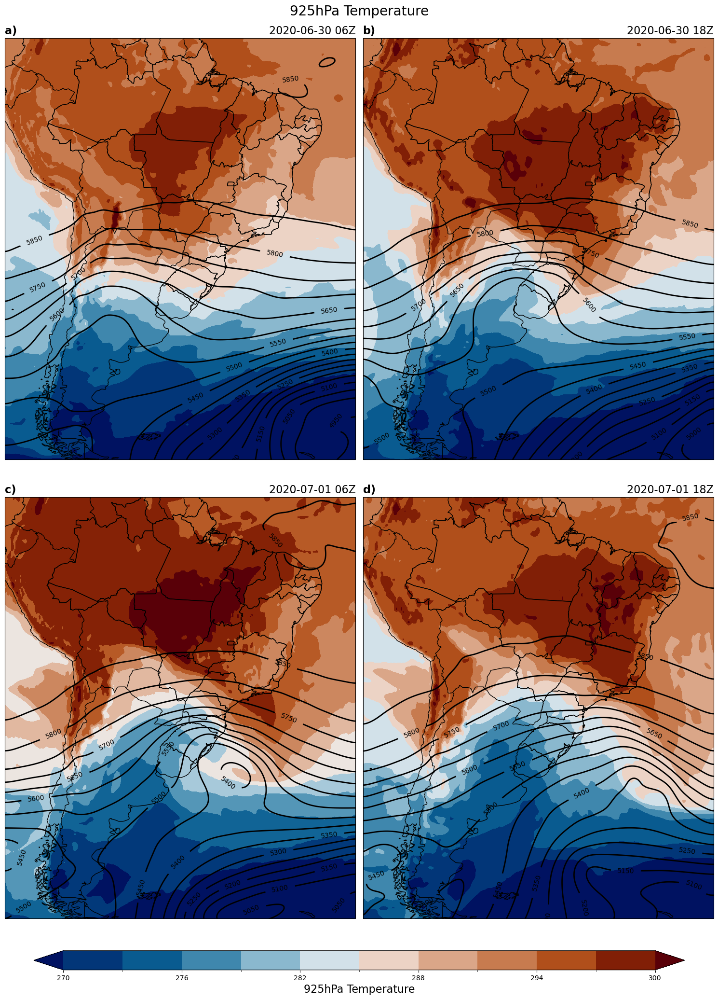

In [287]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = era_temp['t'].sel(time=tt).sel(level=925).plot.contourf(ax=ax, levels=11, cmap=cm.vik, add_colorbar=False, vmin=270, vmax=300)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('925hPa Temperature', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('925hPa Temperature', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

## temp potencial eq

In [296]:
#calculate dewpoint from relative humidity
era_temp['dewpoint'] = mpcalc.dewpoint_from_relative_humidity(era_temp['t']* units.degK, era_temp['r']* units.percent)
#now calculate the equivalent potential temperature
era_temp['theta_e'] = mpcalc.equivalent_potential_temperature(era_temp['level'] * units.hPa, era_temp['t'], era_temp['dewpoint'])

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\767884392.py:2: UserWarning: Relative humidity >120%, ensure proper units.
  era_temp['dewpoint'] = mpcalc.dewpoint_from_relative_humidity(era_temp['t']* units.degK, era_temp['r']* units.percent)


C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\1560230459.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


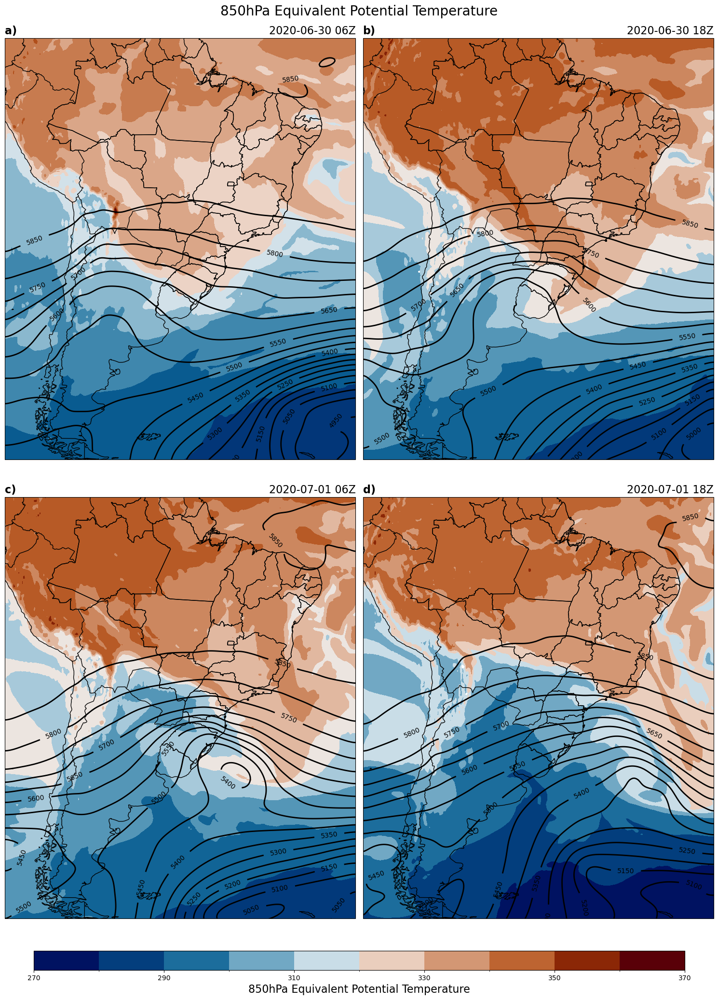

In [303]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
  

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    ax = axes[i]
    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    im = era_temp['theta_e'].sel(time=tt).sel(level=850).plot.contourf(ax=ax, levels=11, cmap=cm.vik, add_colorbar=False, vmin=270, vmax=370)

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('850hPa Equivalent Potential Temperature', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('850hPa Equivalent Potential Temperature', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()

# temp advection

In [ ]:
ds = era_l.sel(time=tt)
lats = ds.latitude.data
lons = ds.longitude.data

In [310]:
#calculate the temperature advection
adv = mpcalc.advection(era_temp['t'].sel(level=850), u=era_l['u'].sel(level=850), v=era_l['v'].sel(level=850)) 
ds['adv'] = gaussian_filter(adv, sigma=3, order=0) * units('K/sec')

C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\2302894519.py:2: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  adv = mpcalc.advection(era_temp['t'].sel(level=850), u=era_l['u'].sel(level=850), v=era_l['v'].sel(level=850))


c:\Users\luisg\anaconda3\envs\geo_env\lib\site-packages\cartopy\mpl\geoaxes.py:1614: UserWarning: The following kwargs were not used by contour: 'legend'
  result = super().contour(*args, **kwargs)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3276077747.py:24: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  adv = mpcalc.advection(ds_temp['t'].sel(level=850), u=ds['u'].sel(level=850), v=ds['v'].sel(level=850))
c:\Users\luisg\anaconda3\envs\geo_env\lib\site-packages\cartopy\mpl\geoaxes.py:1614: UserWarning: The following kwargs were not used by contour: 'legend'
  result = super().contour(*args, **kwargs)
C:\Users\luisg\AppData\Local\Temp\ipykernel_12736\3276077747.py:24: UserWarning: Vertical dimension number not found. Defaulting to (..., Z, Y, X) order.
  adv = mpcalc.advection(ds_temp['t'].sel(level=850), u=ds['u'].sel(level=850), v=ds['v'].sel(level=850))
c:\Users\luisg\anaconda3\envs\geo_env\lib\site-packages\cartopy\mpl\geoaxes.py:1614:

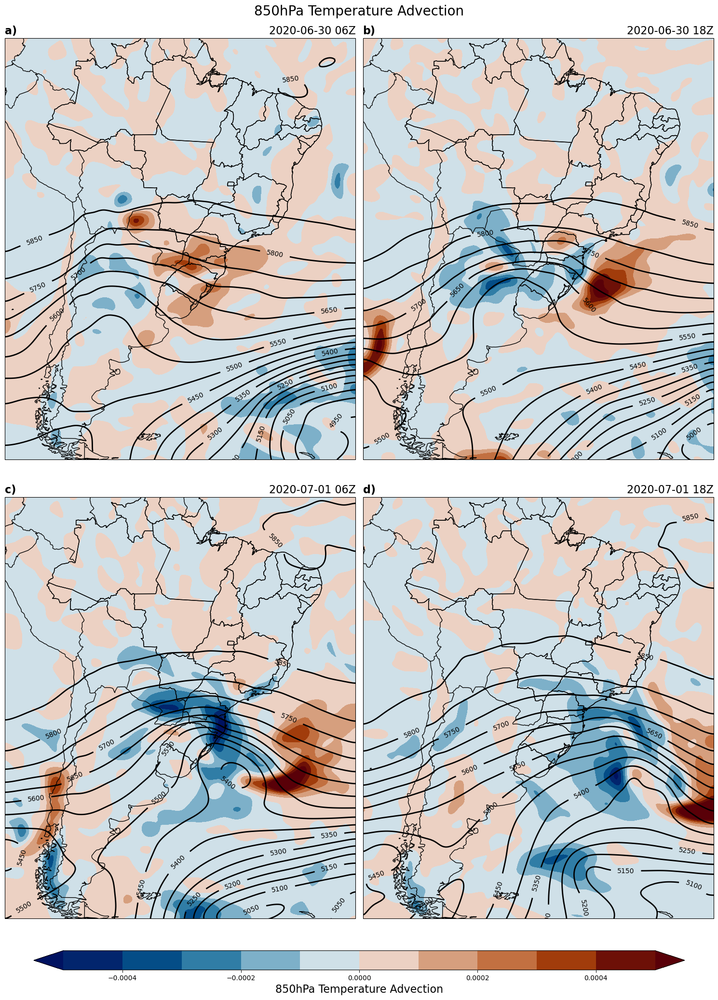

In [326]:
fig, axes = plt.subplots(2, 2, figsize=(15, 20), subplot_kw=dict(projection=datacrs))
axes = axes.flatten()

for i, tt in enumerate(times):
    ds = era_l.sel(time=tt)
    ds_temp = era_temp.sel(time=tt)
    lats = ds.latitude.data
    lons = ds.longitude.data
    strtime = datetime.strptime(tt, '%Y-%m-%dT%H').strftime('%Y-%m-%d %HZ')
    # Select and grab data
    hght = ds['z']
    ax = axes[i]

    # Select and grab 500-hPa geopotential heights and wind components, smooth with gaussian_filter
    hght_500 = gaussian_filter(hght.sel(level=500).data, sigma=3.0)

    # Plot 500-hPa Geopotential Heights in meters
    cs = ax.contour(lons, lats, hght_500, clevs_500_hght, colors='black', linewidths=2.0,
                    transform=datacrs, legend=False)
    ax.clabel(cs, fmt='%d')


    #calculate the temperature advection
    adv = mpcalc.advection(ds_temp['t'].sel(level=850), u=ds['u'].sel(level=850), v=ds['v'].sel(level=850)) 
    adv = gaussian_filter(adv, sigma=3, order=0) * units('K/sec').m
    clev_avoradv = np.linspace(-5*10**-4, 5*10**-4, 11)
 
    im = ax.contourf(ds.longitude, ds.latitude, adv, clev_avoradv,
                 extend='both',
                 cmap=cm.vik, transform=ccrs.PlateCarree())

    # Add geopolitical boundaries for map reference
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'))
    ax.add_feature(cfeature.STATES.with_scale('50m'))
    ax.add_feature(cfeature.BORDERS.with_scale('50m'))
    ax.set_extent([-80, -30, -55, 5], crs=datacrs)
    ax.set_title('')
    ax.set_title(letters[i], fontsize=16, loc='left',fontweight='bold')
    ax.set_title(strtime, fontsize=16, loc='right')
    #ax.text(-79, 1, letters[i], fontsize=22, fontweight='bold', color='black')
cax = fig.add_axes([0.05, -0.02, 0.9, 0.02])
cb = fig.colorbar(im, cax=cax, orientation='horizontal')
cb.set_label('850hPa Temperature Advection', size=16)
#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)
fig.suptitle('850hPa Temperature Advection', fontsize=20)

#fig.colorbar(cf, orientation='horizontal', pad=0, aspect=50)


plt.tight_layout()
plt.show()